# Imports

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [117]:
import os
import glob
import shutil
from collections import Counter
import random
from pathlib import Path

import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from PIL import Image

import numpy as np
from tqdm import tqdm

import sklearn.metrics

import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torch.utils.data.sampler import WeightedRandomSampler
from torchvision import transforms
from torchvision.utils import save_image
import torchvision

In [62]:
CORE_PATH = "/content/drive/MyDrive/data/EMOTIONS_DIPLOMA"
ORIG_PATH = f"{CORE_PATH}/emotions"
SAVE_LOGS_PATH = f"{CORE_PATH}/missclassified"
SAVE_MODELS_PATH = f"{CORE_PATH}/models"

# EDA

In [4]:
data = ImageFolder(ORIG_PATH)
data

Dataset ImageFolder
    Number of datapoints: 496
    Root location: /content/drive/MyDrive/data/EMOTIONS_DIPLOMA/emotions

In [5]:
emotions = os.listdir(ORIG_PATH)
emotions

['fear', 'sadness', 'disgust', 'contempt', 'anger', 'joy', 'wonder']

In [6]:
class_to_idx = data.class_to_idx
idx_to_class = {v: k for k, v in class_to_idx.items()}

In [7]:
def get_distribution_plot(targets: list, title="Number of images"):
    primary_distribution = Counter(targets)
    sorted_values = sorted(primary_distribution)

    fig = go.Figure(
        go.Bar(
            x=[idx_to_class[x] for x in sorted_values],
            y=[primary_distribution[x] for x in sorted_values],
        )
    )
    fig.update_layout(
        width=600,
        height=400,
        title=title
    )
    fig.show(renderer="colab")

In [8]:
get_distribution_plot(data.targets)

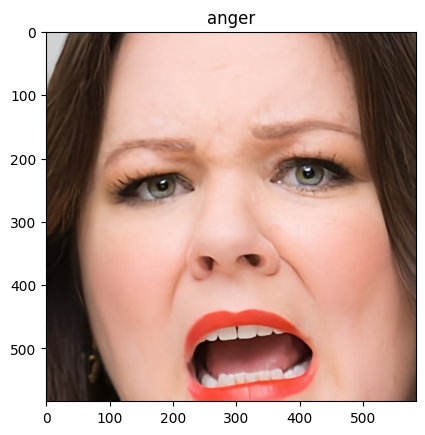

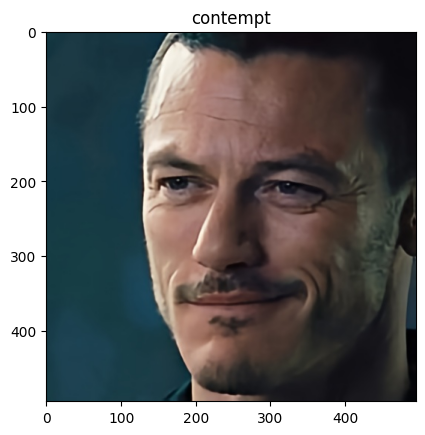

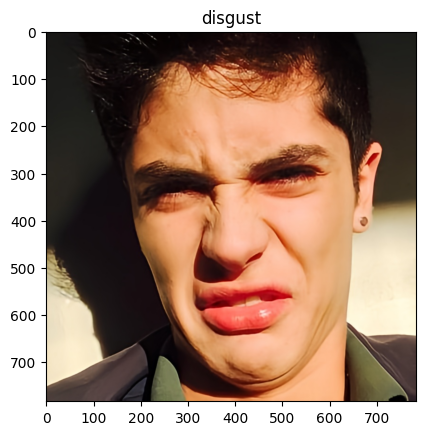

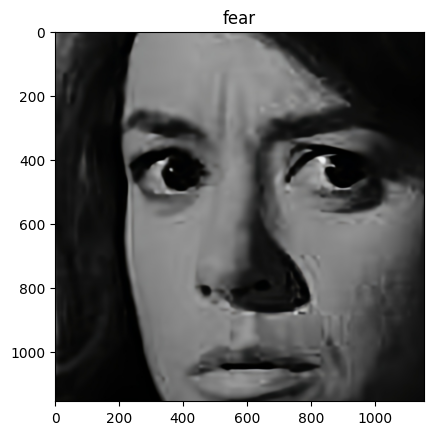

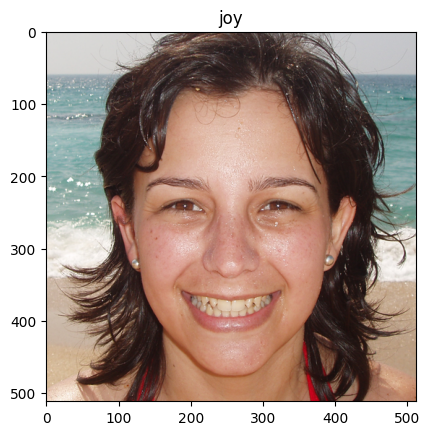

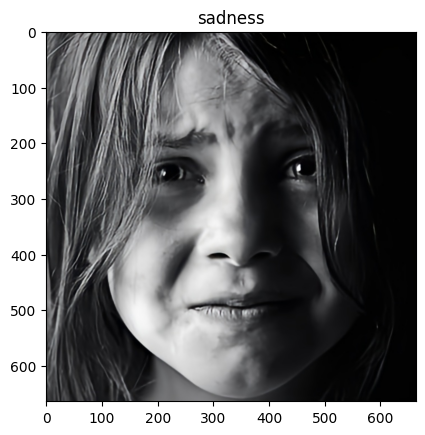

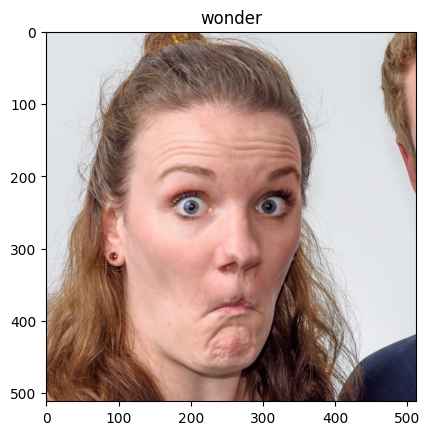

In [9]:
image_index = {x: np.random.choice(np.where(np.array(data.targets) == x)[0])
               for x in idx_to_class.keys()}

for class_id, data_id in image_index.items():
    plt.imshow(data[data_id][0])
    plt.title(f"{idx_to_class[class_id]}")
    plt.show()

# Data Splitting

In [10]:
torch.manual_seed(0)

train_size = 0.75
val_size = 0.1
test_size = 1 - train_size - val_size

train_data, val_data, test_data = torch.utils.data.random_split(
    data, [train_size, val_size, test_size]
)

In [11]:
len(train_data), len(val_data), len(test_data)

(373, 49, 74)

In [12]:
get_distribution_plot(np.array(data.targets)[train_data.indices],
                      "Train distribution")

In [13]:
get_distribution_plot(np.array(data.targets)[val_data.indices],
                      "Val distribution")

In [14]:
get_distribution_plot(np.array(data.targets)[test_data.indices],
                      "Test distribution")

# Setup Datasets and DataLoaders

In [15]:
class EmotionsDataset(Dataset):
    def __init__(self, data, transforms=None):
        self.data = data
        self.targets = [x for x in np.array(data.dataset.targets)[data.indices]]
        self.transforms = transforms

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        image, label = self.data[index]
        if self.transforms is not None:
            image = self.transforms(image)
        return image, label

In [16]:
train_transforms = transforms.Compose([transforms.RandomRotation(10),
                                       transforms.RandomResizedCrop(224),
                                       transforms.RandomGrayscale(),
                                       transforms.RandomHorizontalFlip(),
                                       transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406],
                                                            [0.229, 0.224, 0.225])])

inf_transforms = transforms.Compose([transforms.Resize(224),
                                     transforms.CenterCrop(224),
                                     transforms.ToTensor(),
                                     transforms.Normalize([0.485, 0.456, 0.406],
                                                          [0.229, 0.224, 0.225])])

train_dataset = EmotionsDataset(train_data, train_transforms)
val_dataset = EmotionsDataset(val_data, inf_transforms)
test_dataset = EmotionsDataset(test_data, inf_transforms)

In [17]:
len(train_dataset) + len(val_dataset) + len(test_dataset)

496

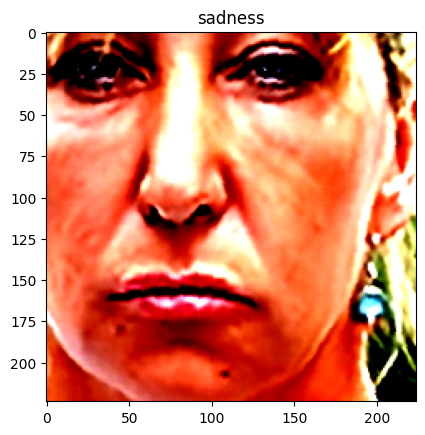

In [18]:
a = random.randint(0, len(train_dataset) - 1)

plt.title(idx_to_class[train_dataset[a][1]])
plt.imshow(train_dataset[a][0].permute(1, 2, 0))

In [19]:
def get_loader(dataset: EmotionsDataset, BATCH_SIZE=16):
    distrib = Counter(dataset.targets)
    class_weights = {x: len(dataset) / distrib[x] for x in distrib.keys()}
    sample_weights = [class_weights[x] for x in dataset.targets]
    sampler = WeightedRandomSampler(sample_weights, len(sample_weights))

    return DataLoader(dataset, BATCH_SIZE, sampler=sampler)

# Utility functions

In [20]:
def get_f1_score(true, pred):
    return sklearn.metrics.f1_score(true, pred, average="micro")

In [61]:
class EarlyStopping():
    def __init__(self, patience=4):
        self.last_value = 1_000_000
        self.current_patience = 0
        self.patience = patience

    def __call__(self, new_value) -> bool:
        if new_value > self.last_value:
            self.current_patience += 1
        else:
            self.current_patience = 0
        self.last_value = new_value
        if self.current_patience > self.patience:
            return True
        return False

In [47]:
def train_model(
    model,
    train_loader,
    val_loader,
    epochs,
    criterion,
    optimizer,
    device,
    best_model_path: str,
    scheduler=None,
    early_stopping: EarlyStopping = None
):
    model.to(device)
    train_loss = []
    val_loss = []
    best_loss = 1_000_000

    for step, epoch in enumerate(range(epochs)):
        loss_per_batch = 0.0
        train_batch_f1_score = []
        val_batch_f1_score = []

        model.train()
        for image, label in tqdm(train_loader):
            optimizer.zero_grad()
            image, label = image.to(device), label.to(device)

            output = model(image)
            output_pred = output.max(1)[1].data  # get the predicted class
            loss = criterion(output, label)
            loss.backward()
            optimizer.step()

            loss_per_batch += loss.item() * output.shape[0]
            train_batch_f1_score.append(get_f1_score(label.cpu(), output_pred.cpu().numpy()))

        train_loss.append(loss_per_batch / len(train_loader.dataset))

        if scheduler:
            scheduler.step()

        model.eval()
        with torch.no_grad():
            loss_per_batch = 0.0
            for image, label in val_loader:
                image, label = image.to(device), label.to(device)

                output = model(image)
                output_pred = output.max(1)[1].data
                loss = criterion(output, label)

                loss_per_batch += loss.item() * output.shape[0]
                val_batch_f1_score.append(get_f1_score(label.cpu(), output_pred.cpu().numpy()))

            val_loss.append(loss_per_batch / len(val_loader.dataset))

        print(f"EPOCH: {step + 1}, train_loss: {train_loss[step]}, val_loss: {val_loss[step]}")
        print(f"train_f1: {np.mean(train_batch_f1_score)}, val_f1: {np.mean(val_batch_f1_score)}")
        print()

        if val_loss[step] < best_loss:
            best_loss = val_loss[step]
            torch.save(model.state_dict(), best_model_path)

        if early_stopping is not None:
            need_to_stop = early_stopping(val_loss[step])
            if need_to_stop is True:
                print("Early Stopping!")
                return train_loss, val_loss

    return train_loss, val_loss

In [66]:
def test_model(model, loader, device):
    model.eval()
    test_f1_score = []
    for image, label in loader:
        output = model(image.to(device))
        output_pred = output.max(1)[1].data
        test_f1_score.append(get_f1_score(label.cpu(), output_pred.cpu().numpy()))

    print(np.mean(test_f1_score))

In [24]:
# source: https://www.kaggle.com/code/nkitgupta/evaluation-metrics-for-multi-class-classification
def roc_auc_score_multiclass(actual_class, pred_class, average = "macro"):
    unique_class = set(actual_class)
    roc_auc_dict = {}
    for per_class in unique_class:
        other_class = [x for x in unique_class if x != per_class]
        new_actual_class = [0 if x in other_class else 1 for x in actual_class]
        new_pred_class = [0 if x in other_class else 1 for x in pred_class]
        roc_auc = sklearn.metrics.roc_auc_score(new_actual_class, new_pred_class, average = average)
        roc_auc_dict[per_class] = roc_auc

    return roc_auc_dict

def get_metrics_report(true, pred):
    return {
        "Accuracy": sklearn.metrics.accuracy_score(true, pred),
        "Precision_macro": sklearn.metrics.precision_score(true, pred, average='macro'),
        "Precision_micro": sklearn.metrics.precision_score(true, pred, average='micro'),
        "Recall_macro": sklearn.metrics.recall_score(true, pred, average='macro'),
        "Recall_micro": sklearn.metrics.recall_score(true, pred, average='micro'),
        "ROC_AUC": roc_auc_score_multiclass(true, pred)
    }

In [25]:
def get_classification_report(true, pred):
    t, p = np.array(true), np.array(pred)
    for _class in set(t):
        indices_class = np.where(t == _class)[0]
        correct = t[indices_class]
        predicted = p[indices_class]

        print(f"{idx_to_class[_class]} emotion")
        print(f"Overall images: {len(indices_class)}")
        print(f"Correctly predicted {(correct == predicted).sum()}/{len(indices_class)}")
        print()

In [118]:
def get_mistaken_images_report(path_list, actual, pred, model_name):
    for ind, (actual, pred) in enumerate(zip(actual, pred)):
        if actual == pred:
            continue

        image = Image.open(path_list[ind]).convert("RGB")
        save_path = f'{SAVE_LOGS_PATH}/{model_name}/'
        Path(save_path).mkdir(parents=True, exist_ok=True)

        plt.title(f"True: {idx_to_class[actual]}, Predicted: {idx_to_class[pred]}")
        plt.imshow(image)
        plt.savefig(f'{save_path}image_{ind}.png')
        plt.show()

In [95]:
def inference_model(model, path_list, device):
    model.to(device)
    model.eval()

    pred = []
    for f in path_list:
        image = Image.open(f).convert('RGB')
        tensor = inf_transforms(image).to(device)
        predicted = model(tensor.unsqueeze(0)).max(1)[1].data.cpu().item()
        pred.append(predicted)

    return pred

# Training setup

In [56]:
BATCH_SIZE = 16
LR = 0.001
EPOCHS = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
criterion = nn.CrossEntropyLoss()

In [57]:
train_loader = get_loader(train_dataset, BATCH_SIZE)
val_loader = DataLoader(val_dataset, BATCH_SIZE)
test_loader = DataLoader(test_dataset, BATCH_SIZE)

# RESNET50

In [58]:
from torchvision.models import resnet50, ResNet50_Weights

In [59]:
model = resnet50(weights=ResNet50_Weights.DEFAULT)

for name, param in model.named_parameters():
    param.requires_grad = False

classifier = nn.Sequential(nn.Linear(model.fc.in_features, 512),
                           nn.ReLU(),
                           nn.Dropout(),
                           nn.Linear(512, len(emotions)))
model.fc = classifier
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

In [60]:
loss_train, loss_val = train_model(
    model,
    train_loader,
    val_loader,
    EPOCHS,
    criterion,
    optimizer,
    device,
    "best_resnet50_100.pt",
    early_stopping=EarlyStopping()
)

100%|██████████| 24/24 [00:09<00:00,  2.58it/s]


EPOCH: 1, train_loss: 1.9307523275508318, val_loss: 1.8536293020053787
train_f1: 0.2119791666666667, val_f1: 0.1875



100%|██████████| 24/24 [00:09<00:00,  2.46it/s]


EPOCH: 2, train_loss: 1.8132987776646345, val_loss: 1.76953116728335
train_f1: 0.2765625, val_f1: 0.21875



100%|██████████| 24/24 [00:11<00:00,  2.09it/s]


EPOCH: 3, train_loss: 1.735062909190201, val_loss: 1.6671329469096905
train_f1: 0.32083333333333336, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.36it/s]


EPOCH: 4, train_loss: 1.6760639888671385, val_loss: 1.619198852655839
train_f1: 0.3494791666666666, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.34it/s]


EPOCH: 5, train_loss: 1.5454683016196653, val_loss: 1.5675844951551787
train_f1: 0.41510416666666666, val_f1: 0.265625



100%|██████████| 24/24 [00:11<00:00,  2.05it/s]


EPOCH: 6, train_loss: 1.4576774445679488, val_loss: 1.5698985712868827
train_f1: 0.44427083333333334, val_f1: 0.3125



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 7, train_loss: 1.478613464825914, val_loss: 1.5509442455914555
train_f1: 0.4328125, val_f1: 0.59375



100%|██████████| 24/24 [00:10<00:00,  2.30it/s]


EPOCH: 8, train_loss: 1.3727741720849005, val_loss: 1.4742882227411076
train_f1: 0.509375, val_f1: 0.578125



100%|██████████| 24/24 [00:09<00:00,  2.47it/s]


EPOCH: 9, train_loss: 1.4247085322643414, val_loss: 1.4689818693667043
train_f1: 0.4322916666666667, val_f1: 0.546875



100%|██████████| 24/24 [00:10<00:00,  2.19it/s]


EPOCH: 10, train_loss: 1.3936125554603802, val_loss: 1.4435803136047052
train_f1: 0.5010416666666667, val_f1: 0.5625



100%|██████████| 24/24 [00:10<00:00,  2.23it/s]


EPOCH: 11, train_loss: 1.3528850088170643, val_loss: 1.5076861478844468
train_f1: 0.4744791666666666, val_f1: 0.578125



100%|██████████| 24/24 [00:11<00:00,  2.09it/s]


EPOCH: 12, train_loss: 1.2536187833499652, val_loss: 1.4784975830389528
train_f1: 0.5458333333333333, val_f1: 0.546875



100%|██████████| 24/24 [00:10<00:00,  2.26it/s]


EPOCH: 13, train_loss: 1.260866208945778, val_loss: 1.5180567381333332
train_f1: 0.5161458333333333, val_f1: 0.53125



100%|██████████| 24/24 [00:10<00:00,  2.37it/s]


EPOCH: 14, train_loss: 1.2092166237792765, val_loss: 1.5057161462550261
train_f1: 0.5692708333333333, val_f1: 0.578125



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 15, train_loss: 1.2090405260909338, val_loss: 1.521358991155819
train_f1: 0.578125, val_f1: 0.578125



100%|██████████| 24/24 [00:09<00:00,  2.42it/s]


EPOCH: 16, train_loss: 1.1535312921687682, val_loss: 1.594683576603325
train_f1: 0.553125, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.33it/s]


EPOCH: 17, train_loss: 1.18166290339452, val_loss: 1.60853703411258
train_f1: 0.5645833333333333, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 18, train_loss: 1.1658644541978196, val_loss: 1.5273274304915447
train_f1: 0.5765625, val_f1: 0.328125



100%|██████████| 24/24 [00:09<00:00,  2.46it/s]


EPOCH: 19, train_loss: 1.0613889834836086, val_loss: 1.6461806759542348
train_f1: 0.5838541666666667, val_f1: 0.46875



100%|██████████| 24/24 [00:10<00:00,  2.23it/s]


EPOCH: 20, train_loss: 1.0601638587486328, val_loss: 1.572975487125163
train_f1: 0.5791666666666667, val_f1: 0.546875



100%|██████████| 24/24 [00:10<00:00,  2.37it/s]


EPOCH: 21, train_loss: 1.0333832352155015, val_loss: 1.6024495338907048
train_f1: 0.6072916666666667, val_f1: 0.578125



100%|██████████| 24/24 [00:10<00:00,  2.21it/s]


EPOCH: 22, train_loss: 1.1272093962088987, val_loss: 1.5081483612255173
train_f1: 0.5692708333333333, val_f1: 0.515625



100%|██████████| 24/24 [00:11<00:00,  2.11it/s]


EPOCH: 23, train_loss: 1.057747081840965, val_loss: 1.4808078615032896
train_f1: 0.6369791666666667, val_f1: 0.546875



100%|██████████| 24/24 [00:11<00:00,  2.08it/s]


EPOCH: 24, train_loss: 1.0655696992899713, val_loss: 1.503225462777274
train_f1: 0.61875, val_f1: 0.640625



100%|██████████| 24/24 [00:10<00:00,  2.31it/s]


EPOCH: 25, train_loss: 1.0626921327759689, val_loss: 1.565098871990126
train_f1: 0.6135416666666667, val_f1: 0.3125



100%|██████████| 24/24 [00:09<00:00,  2.48it/s]


EPOCH: 26, train_loss: 0.9642293098465048, val_loss: 1.5830462611451441
train_f1: 0.6505208333333333, val_f1: 0.28125



100%|██████████| 24/24 [00:09<00:00,  2.53it/s]


EPOCH: 27, train_loss: 1.0350805466680042, val_loss: 1.6179962206859977
train_f1: 0.6291666666666667, val_f1: 0.34375



100%|██████████| 24/24 [00:11<00:00,  2.16it/s]


EPOCH: 28, train_loss: 0.9682944298749315, val_loss: 1.535798075247784
train_f1: 0.6088541666666667, val_f1: 0.546875



100%|██████████| 24/24 [00:10<00:00,  2.37it/s]


EPOCH: 29, train_loss: 0.9345069142512917, val_loss: 1.6660595621381487
train_f1: 0.665625, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.33it/s]


EPOCH: 30, train_loss: 0.9389805598808677, val_loss: 1.6468786901357222
train_f1: 0.6557291666666667, val_f1: 0.3125



100%|██████████| 24/24 [00:09<00:00,  2.43it/s]


EPOCH: 31, train_loss: 0.9533628567294206, val_loss: 1.4985615915181685
train_f1: 0.6390625, val_f1: 0.3125



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 32, train_loss: 0.9933929149331101, val_loss: 1.676015861180364
train_f1: 0.6140625000000001, val_f1: 0.28125



100%|██████████| 24/24 [00:09<00:00,  2.62it/s]


EPOCH: 33, train_loss: 0.9132962105421215, val_loss: 1.6036444148238824
train_f1: 0.6317708333333333, val_f1: 0.3125



100%|██████████| 24/24 [00:09<00:00,  2.49it/s]


EPOCH: 34, train_loss: 0.9519461364592687, val_loss: 1.6265222150452283
train_f1: 0.6395833333333333, val_f1: 0.3125



100%|██████████| 24/24 [00:10<00:00,  2.27it/s]


EPOCH: 35, train_loss: 0.8998047030323632, val_loss: 1.5043225823616495
train_f1: 0.6833333333333332, val_f1: 0.328125



100%|██████████| 24/24 [00:10<00:00,  2.31it/s]


EPOCH: 36, train_loss: 0.8323515701549622, val_loss: 1.66433428258312
train_f1: 0.6932291666666667, val_f1: 0.5625



100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


EPOCH: 37, train_loss: 0.8912836303659802, val_loss: 1.549499969093167
train_f1: 0.6749999999999999, val_f1: 0.3125



100%|██████████| 24/24 [00:09<00:00,  2.45it/s]


EPOCH: 38, train_loss: 0.8239620150573771, val_loss: 1.6430958290489353
train_f1: 0.6963541666666666, val_f1: 0.296875



100%|██████████| 24/24 [00:08<00:00,  2.67it/s]


EPOCH: 39, train_loss: 0.8893535750800738, val_loss: 1.626224269672316
train_f1: 0.6734375, val_f1: 0.515625



100%|██████████| 24/24 [00:09<00:00,  2.48it/s]


EPOCH: 40, train_loss: 0.7959330355194235, val_loss: 1.7709179605756487
train_f1: 0.6921875000000001, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.19it/s]


EPOCH: 41, train_loss: 0.9049251437506791, val_loss: 1.7494399206978934
train_f1: 0.7135416666666666, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


EPOCH: 42, train_loss: 0.7585275869906428, val_loss: 1.6085751397269112
train_f1: 0.7098958333333334, val_f1: 0.390625



100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


EPOCH: 43, train_loss: 0.8414167734637018, val_loss: 1.6050588671041994
train_f1: 0.6869791666666667, val_f1: 0.5625



100%|██████████| 24/24 [00:09<00:00,  2.51it/s]


EPOCH: 44, train_loss: 0.8609145850981847, val_loss: 1.4244224429130554
train_f1: 0.6572916666666667, val_f1: 0.59375



100%|██████████| 24/24 [00:10<00:00,  2.27it/s]


EPOCH: 45, train_loss: 0.8819438225462354, val_loss: 1.6913780119954323
train_f1: 0.6479166666666667, val_f1: 0.296875



100%|██████████| 24/24 [00:09<00:00,  2.47it/s]


EPOCH: 46, train_loss: 0.8530444143285061, val_loss: 1.662877301780545
train_f1: 0.696875, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.23it/s]


EPOCH: 47, train_loss: 0.8693931368017325, val_loss: 1.7362970503009096
train_f1: 0.6760416666666668, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 48, train_loss: 0.791952041774269, val_loss: 1.6055231775556291
train_f1: 0.6989583333333332, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.23it/s]


EPOCH: 49, train_loss: 0.7779593122548776, val_loss: 1.740945728457704
train_f1: 0.6854166666666667, val_f1: 0.25



100%|██████████| 24/24 [00:10<00:00,  2.30it/s]


EPOCH: 50, train_loss: 0.8175549686114846, val_loss: 1.736925679810193
train_f1: 0.6880208333333333, val_f1: 0.28125



100%|██████████| 24/24 [00:11<00:00,  2.12it/s]


EPOCH: 51, train_loss: 0.7496840515980452, val_loss: 1.6253085477011544
train_f1: 0.7229166666666668, val_f1: 0.3125



100%|██████████| 24/24 [00:10<00:00,  2.24it/s]


EPOCH: 52, train_loss: 0.7532251200791019, val_loss: 1.6425797598702567
train_f1: 0.7041666666666666, val_f1: 0.296875



100%|██████████| 24/24 [00:09<00:00,  2.45it/s]


EPOCH: 53, train_loss: 0.7534709951513254, val_loss: 1.725285707687845
train_f1: 0.725, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.34it/s]


EPOCH: 54, train_loss: 0.7864302080374301, val_loss: 1.930003942275534
train_f1: 0.7203125, val_f1: 0.21875



100%|██████████| 24/24 [00:09<00:00,  2.48it/s]


EPOCH: 55, train_loss: 0.6314679334694195, val_loss: 1.7944801340297776
train_f1: 0.7994791666666666, val_f1: 0.53125



100%|██████████| 24/24 [00:10<00:00,  2.31it/s]


EPOCH: 56, train_loss: 0.7538338177325579, val_loss: 1.8366994930773366
train_f1: 0.696875, val_f1: 0.234375



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 57, train_loss: 0.7574401243762101, val_loss: 1.6834681569313517
train_f1: 0.7151041666666668, val_f1: 0.328125



100%|██████████| 24/24 [00:10<00:00,  2.29it/s]


EPOCH: 58, train_loss: 0.7376375501980411, val_loss: 1.885145562035697
train_f1: 0.7156250000000001, val_f1: 0.234375



100%|██████████| 24/24 [00:10<00:00,  2.31it/s]


EPOCH: 59, train_loss: 0.6530530230609086, val_loss: 1.6652774226908782
train_f1: 0.7671875, val_f1: 0.515625



100%|██████████| 24/24 [00:09<00:00,  2.66it/s]


EPOCH: 60, train_loss: 0.753308459996538, val_loss: 1.6952569861801303
train_f1: 0.7312500000000001, val_f1: 0.46875



100%|██████████| 24/24 [00:10<00:00,  2.21it/s]


EPOCH: 61, train_loss: 0.6852397067776954, val_loss: 1.6606275451426604
train_f1: 0.7390625000000001, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.29it/s]


EPOCH: 62, train_loss: 0.6911318487520193, val_loss: 1.6472100870949882
train_f1: 0.7546875000000001, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.36it/s]


EPOCH: 63, train_loss: 0.6993652725187767, val_loss: 1.7697753711622588
train_f1: 0.7734375, val_f1: 0.25



100%|██████████| 24/24 [00:10<00:00,  2.24it/s]


EPOCH: 64, train_loss: 0.7429636304563875, val_loss: 1.7132138330109266
train_f1: 0.7088541666666667, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.22it/s]


EPOCH: 65, train_loss: 0.6534274552846402, val_loss: 1.7912535132194052
train_f1: 0.7703125000000001, val_f1: 0.234375



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 66, train_loss: 0.6441594538036683, val_loss: 1.871997205578551
train_f1: 0.7958333333333334, val_f1: 0.328125



100%|██████████| 24/24 [00:10<00:00,  2.36it/s]


EPOCH: 67, train_loss: 0.7594669627440199, val_loss: 1.8528379907413406
train_f1: 0.7182291666666667, val_f1: 0.34375



100%|██████████| 24/24 [00:10<00:00,  2.34it/s]


EPOCH: 68, train_loss: 0.7302886193303576, val_loss: 1.8312803531179622
train_f1: 0.7359375, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.38it/s]


EPOCH: 69, train_loss: 0.7420677253452127, val_loss: 1.9340681007930212
train_f1: 0.7260416666666667, val_f1: 0.3125



100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


EPOCH: 70, train_loss: 0.6899710275212817, val_loss: 1.753408514723486
train_f1: 0.7286458333333333, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.38it/s]


EPOCH: 71, train_loss: 0.5779938411776566, val_loss: 1.9477345602852958
train_f1: 0.775, val_f1: 0.28125



100%|██████████| 24/24 [00:09<00:00,  2.55it/s]


EPOCH: 72, train_loss: 0.6831705114796718, val_loss: 2.0532282079969133
train_f1: 0.7520833333333333, val_f1: 0.28125



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 73, train_loss: 0.5994299052547833, val_loss: 1.7455815685038665
train_f1: 0.7442708333333333, val_f1: 0.296875



100%|██████████| 24/24 [00:09<00:00,  2.59it/s]


EPOCH: 74, train_loss: 0.7618522886935891, val_loss: 1.8860886534866022
train_f1: 0.7307291666666668, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.34it/s]


EPOCH: 75, train_loss: 0.71323544857649, val_loss: 1.8948790443186858
train_f1: 0.7640625, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.29it/s]


EPOCH: 76, train_loss: 0.7042454557827906, val_loss: 1.9710142369173012
train_f1: 0.74375, val_f1: 0.25



100%|██████████| 24/24 [00:09<00:00,  2.50it/s]


EPOCH: 77, train_loss: 0.6456562806390246, val_loss: 1.9546111968098854
train_f1: 0.7703125000000001, val_f1: 0.25



100%|██████████| 24/24 [00:10<00:00,  2.30it/s]


EPOCH: 78, train_loss: 0.6147201628531591, val_loss: 2.0286771034707827
train_f1: 0.7552083333333334, val_f1: 0.234375



100%|██████████| 24/24 [00:09<00:00,  2.41it/s]


EPOCH: 79, train_loss: 0.7297234989043535, val_loss: 2.0388835449608003
train_f1: 0.7145833333333332, val_f1: 0.203125



100%|██████████| 24/24 [00:08<00:00,  2.83it/s]


EPOCH: 80, train_loss: 0.6062070407752377, val_loss: 1.9310822170607898
train_f1: 0.7859375000000001, val_f1: 0.234375



100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


EPOCH: 81, train_loss: 0.6469360104195234, val_loss: 1.9644872509703344
train_f1: 0.7494791666666667, val_f1: 0.3125



100%|██████████| 24/24 [00:09<00:00,  2.41it/s]


EPOCH: 82, train_loss: 0.7210030101898848, val_loss: 2.0012079161040637
train_f1: 0.7458333333333332, val_f1: 0.25



100%|██████████| 24/24 [00:09<00:00,  2.48it/s]


EPOCH: 83, train_loss: 0.6218116357722806, val_loss: 2.038496358054025
train_f1: 0.7838541666666666, val_f1: 0.296875



100%|██████████| 24/24 [00:09<00:00,  2.50it/s]


EPOCH: 84, train_loss: 0.6709414465657508, val_loss: 1.9420192606595097
train_f1: 0.7421875, val_f1: 0.53125



100%|██████████| 24/24 [00:08<00:00,  2.71it/s]


EPOCH: 85, train_loss: 0.7208266962948817, val_loss: 2.1288309048633187
train_f1: 0.7203125, val_f1: 0.25



100%|██████████| 24/24 [00:09<00:00,  2.40it/s]


EPOCH: 86, train_loss: 0.6854813354584232, val_loss: 2.0072053500584195
train_f1: 0.7380208333333332, val_f1: 0.28125



100%|██████████| 24/24 [00:09<00:00,  2.47it/s]


EPOCH: 87, train_loss: 0.6275803620949507, val_loss: 2.211969959492586
train_f1: 0.7515625, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.37it/s]


EPOCH: 88, train_loss: 0.6970251760278247, val_loss: 1.9013874968703912
train_f1: 0.7645833333333334, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.33it/s]


EPOCH: 89, train_loss: 0.6441876648578183, val_loss: 2.034306117466518
train_f1: 0.7723958333333334, val_f1: 0.265625



100%|██████████| 24/24 [00:10<00:00,  2.23it/s]


EPOCH: 90, train_loss: 0.6747064545710668, val_loss: 2.0715347163531246
train_f1: 0.759375, val_f1: 0.59375



100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


EPOCH: 91, train_loss: 0.6484278683368386, val_loss: 2.0715825946963564
train_f1: 0.7677083333333333, val_f1: 0.328125



100%|██████████| 24/24 [00:09<00:00,  2.45it/s]


EPOCH: 92, train_loss: 0.6379480055126364, val_loss: 1.9864606516701835
train_f1: 0.7567708333333334, val_f1: 0.28125



100%|██████████| 24/24 [00:09<00:00,  2.56it/s]


EPOCH: 93, train_loss: 0.5931702843460257, val_loss: 1.9698358141646093
train_f1: 0.7807291666666667, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.40it/s]


EPOCH: 94, train_loss: 0.6004166686982316, val_loss: 2.0830327637341557
train_f1: 0.7598958333333333, val_f1: 0.203125



100%|██████████| 24/24 [00:09<00:00,  2.40it/s]


EPOCH: 95, train_loss: 0.6791362558708753, val_loss: 2.2188572202410017
train_f1: 0.7494791666666667, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.27it/s]


EPOCH: 96, train_loss: 0.5558347805895051, val_loss: 2.076874297492358
train_f1: 0.7880208333333334, val_f1: 0.25



100%|██████████| 24/24 [00:09<00:00,  2.57it/s]


EPOCH: 97, train_loss: 0.6194419407812584, val_loss: 2.156292200088501
train_f1: 0.7786458333333334, val_f1: 0.25



100%|██████████| 24/24 [00:10<00:00,  2.37it/s]


EPOCH: 98, train_loss: 0.5409351583300582, val_loss: 2.2031349089680887
train_f1: 0.8041666666666667, val_f1: 0.234375



100%|██████████| 24/24 [00:09<00:00,  2.51it/s]


EPOCH: 99, train_loss: 0.5437309364850655, val_loss: 2.0113688099141025
train_f1: 0.7828125, val_f1: 0.296875



100%|██████████| 24/24 [00:10<00:00,  2.31it/s]


EPOCH: 100, train_loss: 0.6260616999848598, val_loss: 2.198849989443409
train_f1: 0.7755208333333333, val_f1: 0.3125



In [63]:
torch.save(model.state_dict(), f"{SAVE_MODELS_PATH}/resnet50_100_train.pt")
shutil.copyfile("best_resnet50_100.pt", f"{SAVE_MODELS_PATH}/best_resnet50_100.pt")

In [73]:
best = resnet50(weights=ResNet50_Weights.DEFAULT)
classifier = nn.Sequential(nn.Linear(best.fc.in_features, 512),
                           nn.ReLU(),
                           nn.Dropout(),
                           nn.Linear(512, len(emotions)))
best.fc = classifier
best.load_state_dict(torch.load(f"{SAVE_MODELS_PATH}/best_resnet50_100.pt"))
best.eval()
best = best.to(device)

In [67]:
test_model(model, test_loader, device)

0.3375


In [74]:
test_model(best, test_loader, device)

0.27749999999999997


In [101]:
data.imgs[0]

('/content/drive/MyDrive/data/EMOTIONS_DIPLOMA/emotions/anger/ffhq_1071.png',
 0)

In [108]:
not_train_indices = val_data.indices + test_data.indices
inf_images = [data.imgs[x][0] for x in not_train_indices]
inf_labels = [data.imgs[x][1] for x in not_train_indices]

preds = inference_model(model, inf_images, device)
get_metrics_report(inf_labels, preds)

{'Accuracy': 0.3821138211382114,
 'Precision_macro': 0.43090112952181914,
 'Precision_micro': 0.3821138211382114,
 'Recall_macro': 0.3511459217474254,
 'Recall_micro': 0.3821138211382114,
 'ROC_AUC': {0: 0.6071428571428571,
  1: 0.6313259109311742,
  2: 0.5278761061946903,
  3: 0.5153846153846154,
  4: 0.866747572815534,
  5: 0.5485714285714286,
  6: 0.667866786678668}}

In [110]:
get_classification_report(inf_labels, preds)

anger emotion
Overall images: 14
Correctly predicted 4/14

contempt emotion
Overall images: 19
Correctly predicted 2/19

disgust emotion
Overall images: 10
Correctly predicted 1/10

fear emotion
Overall images: 13
Correctly predicted 4/13

joy emotion
Overall images: 20
Correctly predicted 15/20

sadness emotion
Overall images: 25
Correctly predicted 13/25

wonder emotion
Overall images: 22
Correctly predicted 5/22



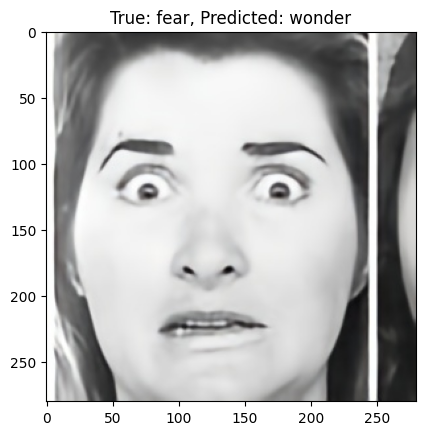

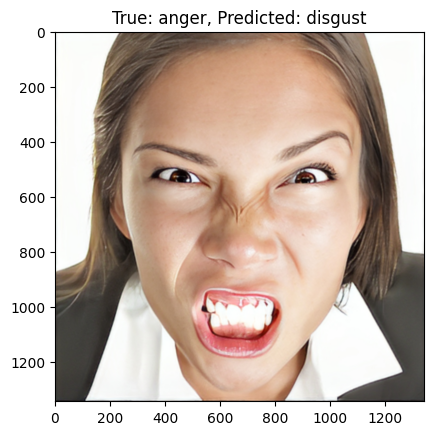

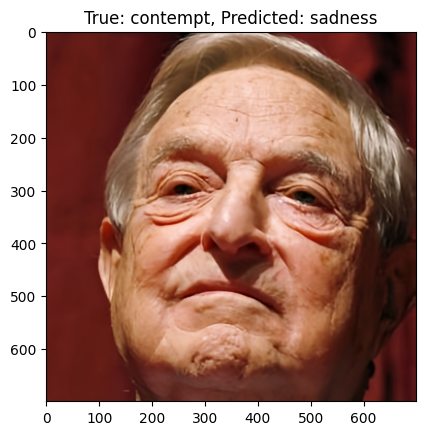

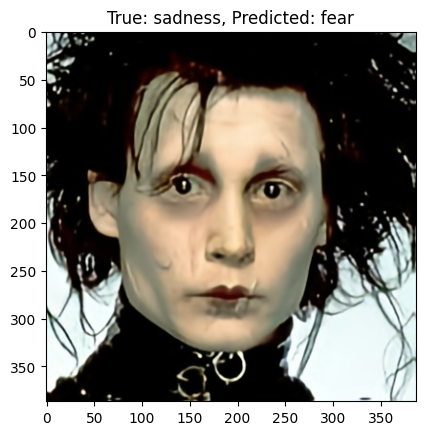

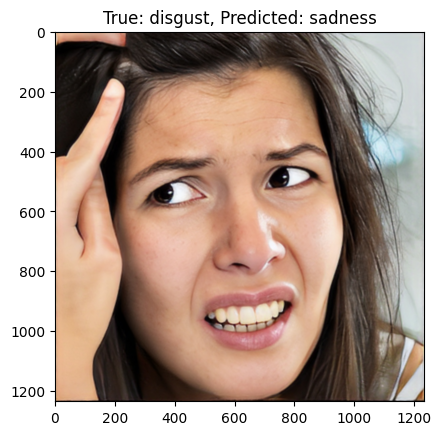

...

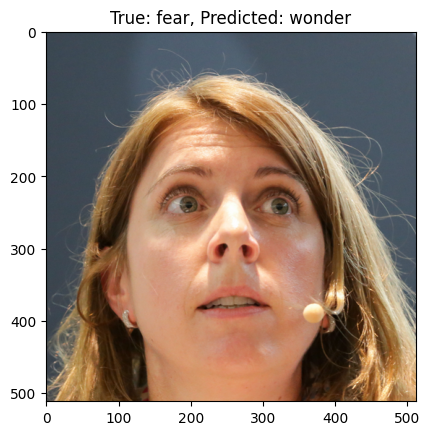

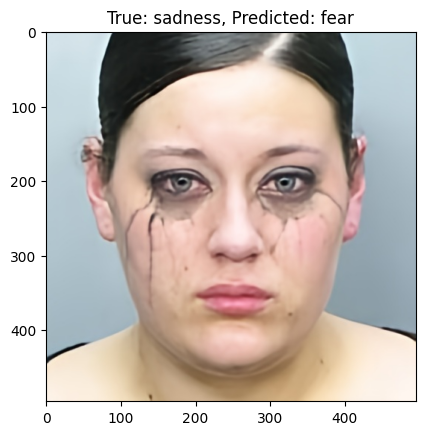

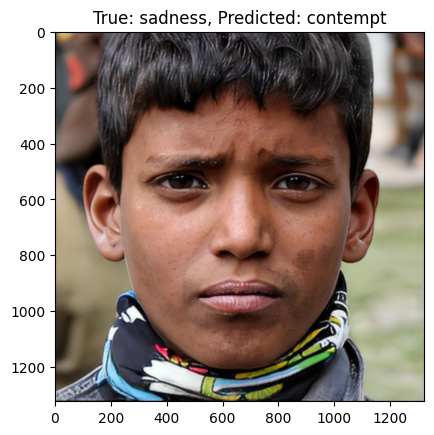

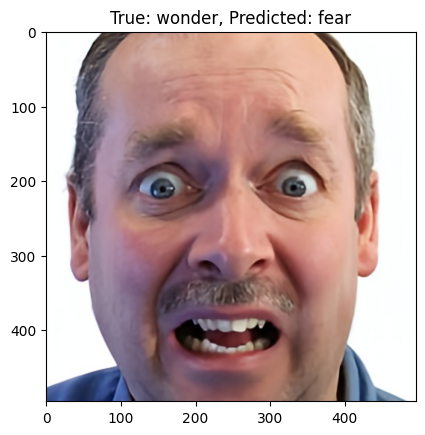

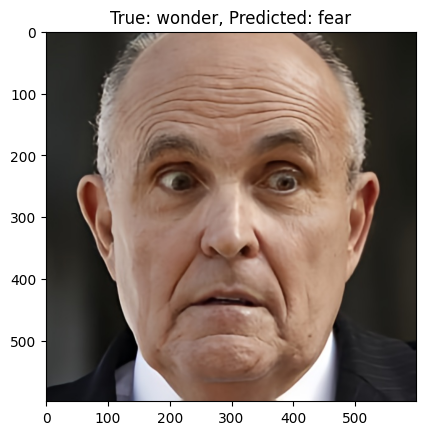

In [119]:
get_mistaken_images_report(inf_images, inf_labels, preds, "resnet50_100")